<a href="https://colab.research.google.com/github/AshwinUnnikrishnan/Solutions/blob/master/AshwinUnnikrishnan_DeepLearningScreenTurtleChallenge_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

*In this challenge you will be asked to build a deep learning solution capable of segmenting turtles on synthetic images. You will be provided with the data, which you can use to train your models; your best model will be used on a test image and you will be asked to implement some geometric algorithms based on the predictions of your model.*

***Training data***

The training data will consist of 30 256x256 images of the same synthetic turtle pasted on background images artificially generated by BigGAN (https://arxiv.org/abs/1809.11096).

Feel free to increase the dataset size as needed and make any relevant changes to the dataset creation.

Each image will come with the ground truth per-pixel segmentation mask which you can leverage for your training setup. We strongly recommend that you treat the provided task as semantic segmentation with 2 classes -- foreground (turtle) and background (everything else).

You are also allowed to use external data sources and pre-trained weights, but please provide justification if you choose to do so.


***Test data***

There will only be a single test image without the provided GT.

The test image differs from the training data and it is up to you to decide how to approach these differences. Notably, the test image is of resolution 512x512 and your predicted mask must be of the same resolution.


***Tasks***

1. Your main task is to build a deep learning model capable of accurately segmenting the turtle in the test image.
2. Based on the segmentation mask predicted by your model, you will need to implement an algorithm that finds a **convex hull** (not concave), i.e. a polygon enclosing all the foreground (i.e. turtle) pixels.
3. Implement an algorithm that calculates the area of the polygon from the result of task 2.

***If you are using third-party code, you have to provide explanation of why you need that code and what that code does. We evaluate your submission based on the code you have written and if there is no such code, we won't be able to evaluate and proceed to the next stage.***

***Rules***

* Please use PyTorch to train your model in task 1.
* Feel free to use all the imported Python libraries
* For tasks 2 and 3 ***you are not allowed*** to use third-party functions that readily solve those tasks, e.g. you are not allowed to use various `cv2` and `scikit-image` operators. We expect the algorithms to be based on points and geometry rather than full-image operations.
* You may modify any provided code, please provide explanation for any significant changes.


***Submission***

* ***You must send us only a single link to the Colab notebook with your solution and nothing else!*** We must be able to reproduce your results by running the notebook in the browser as is. Be careful not to use too much RAM (12G) or GPU (15G) so it does not crash. If you require additional files, use `gdown` to download them into the session storage (see Task 1 for details).
* Include your comments and explanations on the decisions that you made to approach the problem;
* Make sure to include the estimate of approximately how much time it took you to get to the final solution.

***Grading Criteria***

* Output must be correct for all 3 tasks
* Should run in reasonable time without significant inefficiencies. Ideally < 10 minutes, training can take a little longer if needed.
* Code should be clean and readable

***Colab setup***

* To use GPU, go to `Runtime -> Change Runtime Type -> GPU`

In [1]:
# comment the following line if you are working outside of a notebook environment
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import random
from PIL import Image
import gdown

In [2]:
# Used to download any files you need for your solution from Google Drive
gdown.download("https://drive.google.com/uc?id=1ymKI8M73kBIck2b7S7QG02aiP4yXLaML", "turtle.png", quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1ymKI8M73kBIck2b7S7QG02aiP4yXLaML
To: /content/turtle.png
100%|██████████| 692k/692k [00:00<00:00, 139MB/s]


'turtle.png'

In [3]:
# read and visualise the turtle image
turtle_image = Image.open('./turtle.png')
# Perform vertical flip
vertical_flipped_image = turtle_image.transpose(Image.FLIP_TOP_BOTTOM)

# Perform horizontal flip
horizontal_flipped_image = turtle_image.transpose(Image.FLIP_LEFT_RIGHT)

# Perform both vertical and horizontal flips (equivalent to a 180-degree rotation)
both_flipped_image = turtle_image.transpose(Image.ROTATE_180)

# it is a 4-channel RGB+Alpha image of size 2394x1800
print(turtle_image.mode, turtle_image.size)

RGBA (2394, 1800)


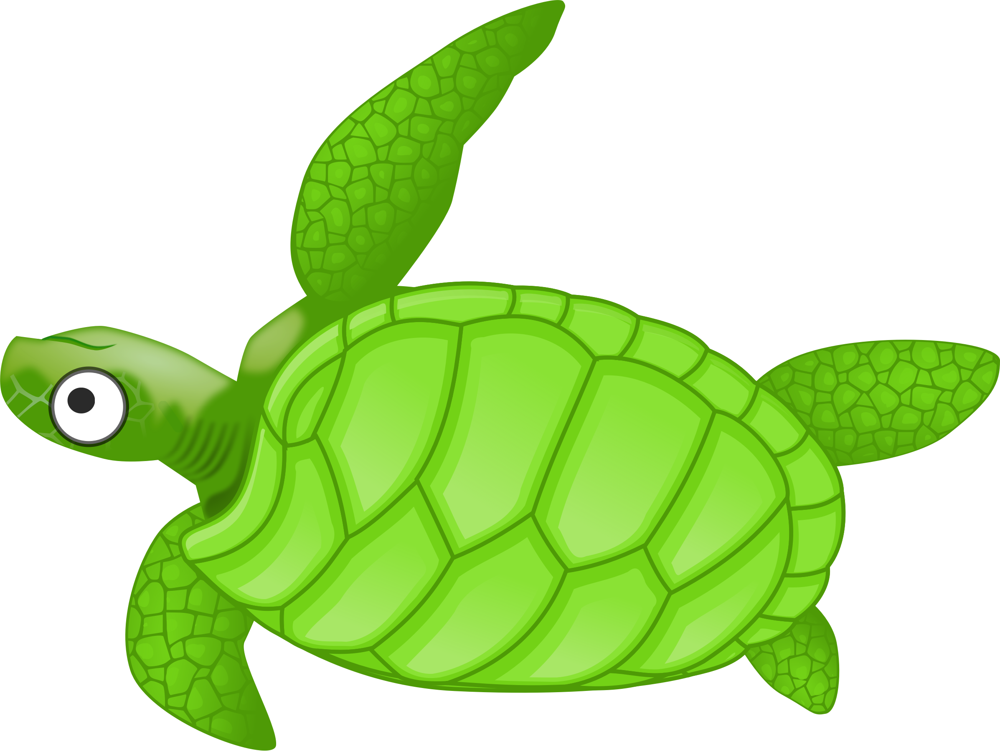

In [4]:
both_flipped_image

In [5]:
# to create the training set, we will resize the turtle image to 256x256
turtle_image_256x256 = turtle_image.resize((256, 256))
both_flipped_image_256x256, horizontal_flipped_image_256x256, vertical_flipped_image_256x256 = both_flipped_image.resize((256, 256)), horizontal_flipped_image.resize((256, 256)), vertical_flipped_image.resize((256, 256))

# Background Images

As written above, we will use a generative adversarial network called "BigGAN" pre-trained on ImageNet to create a set of background images

In [6]:
# first, we need to install the python package called `pytorch_pretrained_biggan` (https://github.com/huggingface/pytorch-pretrained-BigGAN)
# if in the notebook environment, please uncomment the following line to install this package
!pip install pytorch_pretrained_biggan
# there might be some errors related to pip's dependency resolver which you can safely ignore

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 5.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-many

In [7]:
import torch
from pytorch_pretrained_biggan import (
    BigGAN,
    truncated_noise_sample,
    convert_to_images,
    one_hot_from_int,
)

In [8]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
# boilerplate pytorch code enforcing reproducibility
torch.manual_seed(42)
if device.type == "cuda":
    torch.cuda.manual_seed(42)
np.random.seed(42)
random.seed(42)

BigGAN is a memory-intensive network.

To save time and memory, we will only generate 30 different background images.
Feel free to change this setup as needed.

In [12]:
# load the 256x256 model
model = BigGAN.from_pretrained('biggan-deep-256').to(device).eval()

# every time we will run with batch size of 3 in order to not run out of memory
num_passes = 40
batch_size = 4

# default noise value from the provided repository
truncation = 0.4

background_images = []

for _ in range(num_passes):
    # BigGAN uses imagenet and hence each time we will choose one of 1000 categories
    class_vector = torch.from_numpy(
        one_hot_from_int(np.random.randint(0, 1000, size=batch_size), batch_size=batch_size)
    ).to(device)
    noise_vector = torch.from_numpy(
        truncated_noise_sample(truncation=truncation, batch_size=batch_size)
    ).to(device)

    # Generate the images and convert them to PIL image
    with torch.no_grad():
        output = model(noise_vector, class_vector, truncation).cpu()
        background_images.extend(convert_to_images(output))

# We won't need the GAN model anymore,
# so we can safely delete it and free up some memory
del model
torch.cuda.empty_cache()

In [14]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [35]:
import io
import os

In [17]:
print(len(background_images))
print(type(background_images[0]))


160
<class 'PIL.Image.Image'>


In [25]:
!ls /content/drive/MyDrive/Federated/Initial_Images/

In [42]:
def save_images_to_google_drive(background_images, location):

  for i, image in enumerate(background_images):
      # Create a BytesIO object to store image in memory
      image_stream = io.BytesIO()

      # Save the image to the BytesIO object
      image.save(image_stream, format='JPEG')  # You can specify the format here

      # Reset the stream position to the beginning
      image_stream.seek(0)

      # Define destination path in Google Drive
      destination_path = os.path.join(location, f'image_{i}.jpg')  # Adjust folder and file name as needed

      # Copy the image to Google Drive
      with open(destination_path, 'wb') as f:
          f.write(image_stream.read())

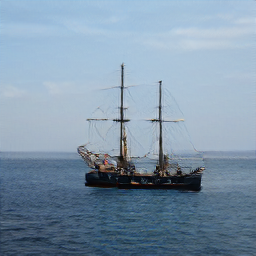

In [27]:
# Let's see how one of the images look like
random.choice(background_images)

# Training Set
Given 30 background images and the turtle image, we will paste the turtle onto the background images.

In [28]:
import torchvision
import torchvision.transforms as transforms

In [29]:
tensor_transform = transforms.ToTensor()

def random_paste(background_image, turtle_image, min_scale=0.25, max_scale=0.65):
    """Randomly scales and pastes the turtle image onto the background image"""

    w, h = turtle_image.size
    # first, we will randomly downscale the turtle image
    new_w = int(random.uniform(min_scale, max_scale) * w)
    new_h = int(random.uniform(min_scale, max_scale) * h)
    resized_turtle_image = turtle_image.resize((new_w, new_h))

    # second, will randomly choose the locations where to paste the new image
    start_w = random.randint(0, w - new_w)
    start_h = random.randint(0, h - new_h)

    # third, will create the blank canvas of the same size as the original image
    canvas_image = Image.new('RGBA', (w, h))

    # and paste the resized turtle onto it, preserving the mask
    canvas_image.paste(resized_turtle_image, (start_w, start_h), resized_turtle_image)

    # Turtle image is of mode RGBA, while background image is of mode RGB;
    # `.paste` requires both of them to be of the same type.
    background_image = background_image.copy().convert('RGBA')
    # finally, will paste the resized turtle onto the background image
    background_image.paste(resized_turtle_image, (start_w, start_h), resized_turtle_image)
    return background_image, canvas_image

In [30]:
def mix_images(training_set, background_images, turtle):
  for background_image in background_images:
  # paste the turtle onto background image
    aug_image, aug_mask = random_paste(background_image.copy(), turtle.copy())
    # convert PIL images to pytorch tensors
    training_pair = [
        tensor_transform(aug_image)[:3],  # keep the rgb only
        # For the mask, we only need the last (4th) channel,
        # and we will encode the mask as boolean
        tensor_transform(aug_mask)[-1:] > 0,
    ]
    training_set.append(training_pair)
  return training_set

In [31]:
training_set = []
training_set = mix_images(training_set, background_images, turtle_image_256x256)
training_set = mix_images(training_set, background_images, both_flipped_image_256x256)
training_set = mix_images(training_set, background_images, horizontal_flipped_image_256x256)
training_set = mix_images(training_set, background_images, vertical_flipped_image_256x256)

In [32]:
len(training_set)

640

In [40]:
image_list= []
mask_list = []
for image, mask in training_set:
  image_list.append(image)
  mask_list.append(mask)

In [45]:
(image_list[0].shape)

torch.Size([3, 256, 256])

In [46]:
def save_images_to_google_drive_images(background_images, location):
    for i, image_tensor in enumerate(background_images):
        # Convert tensor to PIL Image
        image_pil = transforms.ToPILImage()(image_tensor)

        # Create a BytesIO object to store image in memory
        image_stream = io.BytesIO()

        # Save the image to the BytesIO object
        image_pil.save(image_stream, format='JPEG')  # You can specify the format here

        # Reset the stream position to the beginning
        image_stream.seek(0)

        # Define destination path in Google Drive
        destination_path = os.path.join(location, f'image_{i}.jpg')  # Adjust folder and file name as needed

        # Copy the image to Google Drive
        with open(destination_path, 'wb') as f:
            f.write(image_stream.read())

In [55]:
def save_images_to_google_drive_masks(background_images, location):
    for i, image_tensor in enumerate(background_images):
        # Convert tensor to float and then to PIL Image
        image_tensor_float = image_tensor.float()
        image_pil = transforms.ToPILImage()(image_tensor_float.squeeze(0))  # Squeeze to remove the batch dimension

        # Create a BytesIO object to store image in memory
        image_stream = io.BytesIO()

        # Save the image to the BytesIO object
        image_pil.save(image_stream, format='JPEG')  # You can specify the format here

        # Reset the stream position to the beginning
        image_stream.seek(0)

        # Define destination path in Google Drive
        destination_path = os.path.join(location, f'image_{i}.jpg')  # Adjust folder and file name as needed

        # Copy the image to Google Drive
        with open(destination_path, 'wb') as f:
            f.write(image_stream.read())

In [56]:
#save_images_to_google_drive_images(image_list, '/content/drive/MyDrive/Federated/Images')
save_images_to_google_drive_masks(mask_list, '/content/drive/MyDrive/Federated/Masks')

In [54]:
mask_list[0].shape

torch.Size([1, 256, 256])

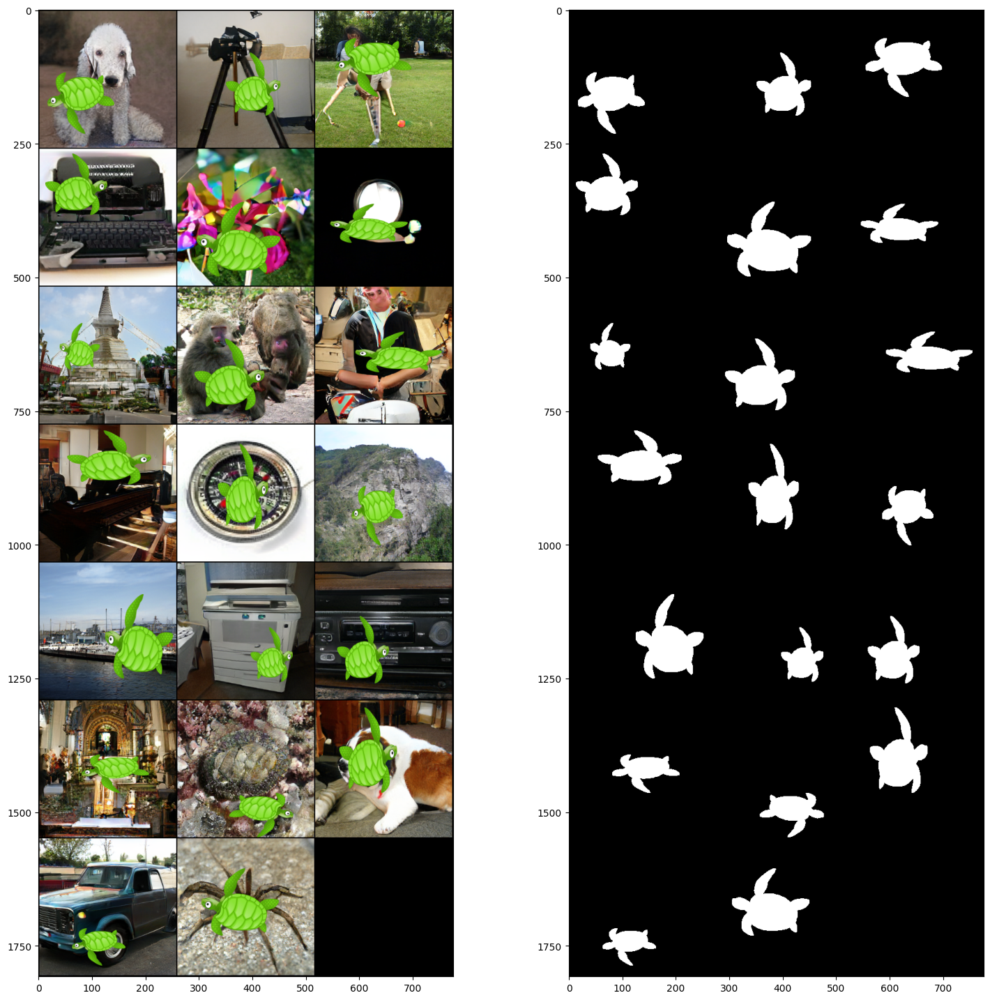

In [57]:
# Let's visualise some subset of the training set
sample_indices = np.random.choice(len(training_set), size=20, replace=False)
sample_images = []
sample_masks = []
for i in sample_indices:
    image, mask = training_set[i]
    sample_images.append(image)
    sample_masks.append(mask)

plt.figure(figsize=(18, 18))
plt.subplot(121)
plt.imshow(torchvision.utils.make_grid(sample_images, nrow=3).permute(1, 2, 0).cpu().numpy())
plt.subplot(122)
plt.imshow(torchvision.utils.make_grid(sample_masks, nrow=3).permute(1, 2, 0).float().cpu().numpy())

# Test Image
Now, let's load the test image. As mentioned above, it is of a slightly higher 512x512 resolution.

Downloading...
From: https://drive.google.com/uc?id=1_55KX8AK8pZ936Zv27t8Q-ZY8BJjuBqa
To: /content/test.png
100%|██████████| 413k/413k [00:00<00:00, 126MB/s]

RGB (512, 512)


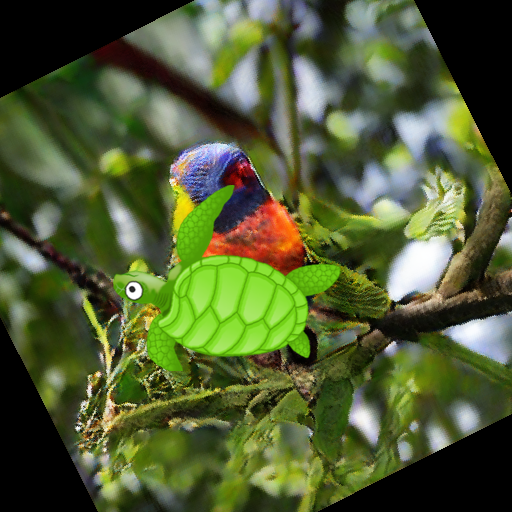

In [34]:
gdown.download("https://drive.google.com/uc?id=1_55KX8AK8pZ936Zv27t8Q-ZY8BJjuBqa", "test.png", quiet=False)
test_image = Image.open('./test.png')
# it is a 3-channel RGB image of size 512x512
print(test_image.mode, test_image.size)
test_image

# Task 1: Predicting segmentation mask

*This is where you need to implement your deep learning solution. Your approach must output a result at the native 512x512 resolution of the test image.*

#### Initializing the libraries

In [58]:
from torch.utils.data import Dataset, DataLoader
from torchvision import models
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torchvision.transforms.functional import to_pil_image, to_tensor

#### Loading the data into a generic data loader

In [59]:
class CustomDataset(Dataset):
    def __init__(self, data_list):
        self.data_list = data_list

    def __len__(self):
        return len(self.data_list)

    def __getitem__(self, index):
        image, mask = self.data_list[index]
        return image, mask
dataset = CustomDataset(training_set)
data_loader = DataLoader(dataset, batch_size=30, shuffle=True)

#### Creating a unet model using pretrained deeplabv3_resnet50 backbone. And creating specific classes for train, test, visualize.

In [60]:
# U-Net model using torchvision
class UNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        """
        Initializes the U-Net model.

        Parameters:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
        """
        super(UNet, self).__init__()
        self.model = models.segmentation.deeplabv3_resnet50(pretrained=False, num_classes=out_channels)

    def forward(self, x):
        """
        Forward pass through the U-Net model.

        Parameters:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: Output tensor.
        """
        return self.model(x)['out']

def train_model(model, train_loader, criterion, optimizer, num_epochs=5, device='cuda'):
    """
    Trains the U-Net model.

    Parameters:
        model (UNet): U-Net model to be trained.
        train_loader (torch.utils.data.DataLoader): Training data loader.
        criterion: Loss function.
        optimizer: Optimization algorithm.
        num_epochs (int): Number of training epochs. Default is 5.
        device (str): Device to run the training on. Default is 'cuda'.
    """
    model.to(device)
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0.0
        for images, masks in train_loader:
            images, masks = images.to(device), masks.to(device).long()
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, masks.squeeze(1))
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        average_loss = total_loss / len(train_loader)
        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {average_loss}")

def test_model(model, test_loader, device='cuda'):
    """
    Tests the U-Net model.

    Parameters:
        model (UNet): U-Net model to be tested.
        test_loader (torch.utils.data.DataLoader): Test data loader.
        device (str): Device to run the testing on. Default is 'cuda'.
    """
    model.eval()
    with torch.no_grad():
        for images, masks in test_loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            predicted_masks = torch.argmax(outputs, dim=1)
            visualize_results(images, masks, predicted_masks)

def visualize_results(images, masks, predicted_masks):
    """
    Visualizes the results of testing the U-Net model.

    Parameters:
        images (torch.Tensor): Input images.
        masks (torch.Tensor): Ground truth masks.
        predicted_masks (torch.Tensor): Predicted masks.
    """
    num_samples = images.size(0)
    for i in range(num_samples):
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(images[i].permute(1, 2, 0).cpu().numpy())
        plt.title('Image')

        plt.subplot(1, 3, 2)
        plt.imshow(masks[i].squeeze().cpu().numpy(), cmap='gray')
        plt.title('Ground Truth Mask')

        plt.subplot(1, 3, 3)
        plt.imshow(predicted_masks[i].cpu().numpy(), cmap='gray')
        plt.title('Predicted Mask')

        plt.show()

In [62]:
criterion = nn.CrossEntropyLoss()
unet_model = UNet(in_channels=3, out_channels=2)  # Assuming 2 classes (foreground and background)
optimizer = optim.Adam(unet_model.parameters(), lr=0.001)

train_model(unet_model, data_loader, criterion, optimizer, num_epochs=10)

torch.save(unet_model.state_dict(), "saved_model.pth")

Epoch 1/10, Loss: 0.3157044994560155
Epoch 2/10, Loss: 0.0461360751227899
Epoch 3/10, Loss: 0.0289349082688039
Epoch 4/10, Loss: 0.022777626121586018
Epoch 5/10, Loss: 0.02044439205730503
Epoch 6/10, Loss: 0.017566250044513832
Epoch 7/10, Loss: 0.016277428293092686
Epoch 8/10, Loss: 0.01525411598215049
Epoch 9/10, Loss: 0.013556999027390371
Epoch 10/10, Loss: 0.01224341510202397


#### Checking how model performs on the trained data

In [2]:
import os
import shutil
import gdown

In [3]:
# Define paths
source_path = 'saved_model.pth'  # Path to your model file
destination_folder = '/content/drive/My Drive/models'  # Destination folder in Google Drive

# Create destination folder if it doesn't exist
os.makedirs(destination_folder, exist_ok=True)

# Define destination path
destination_path = os.path.join(destination_folder, 'saved_model.pth')

# Copy model to Google Drive
shutil.copy(source_path, destination_path)

print("Model saved to Google Drive successfully.")

Model saved to Google Drive successfully.


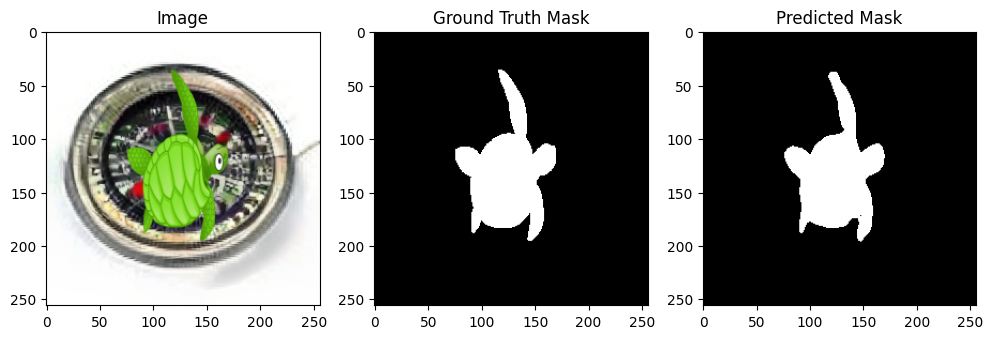

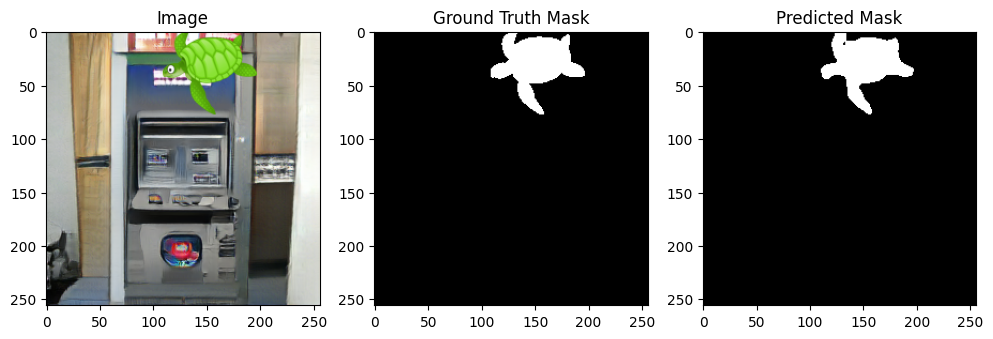

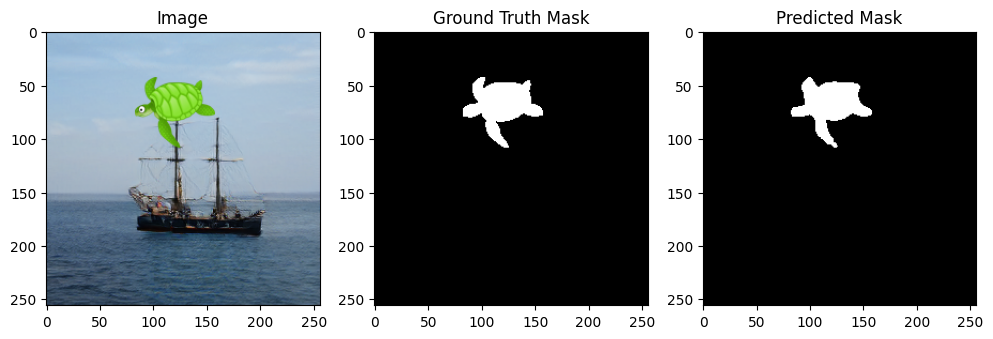

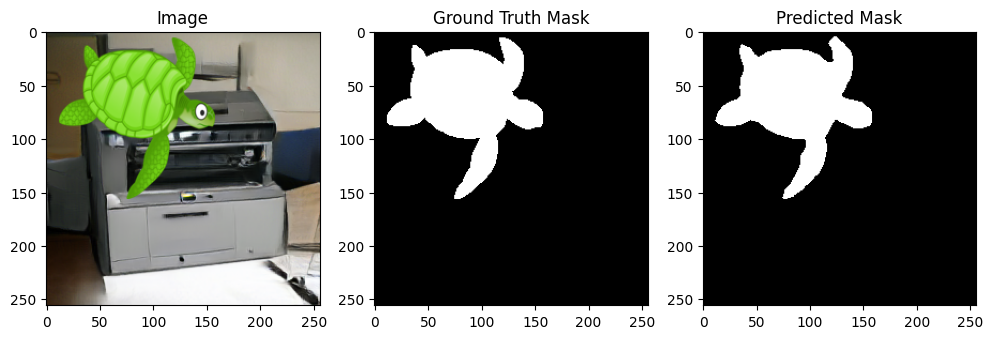

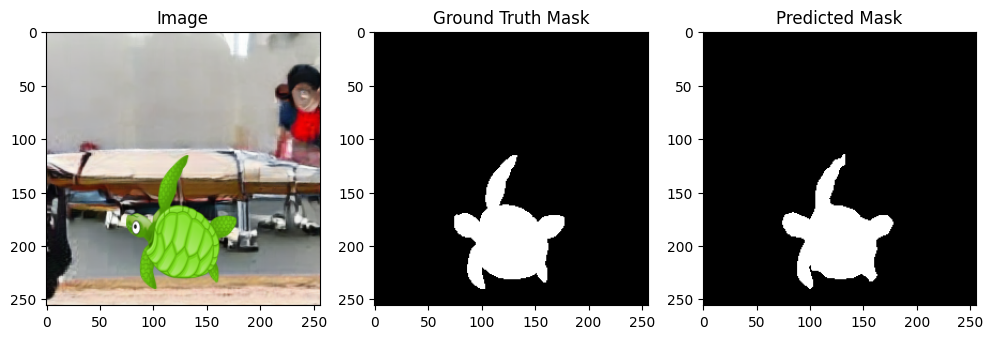

...

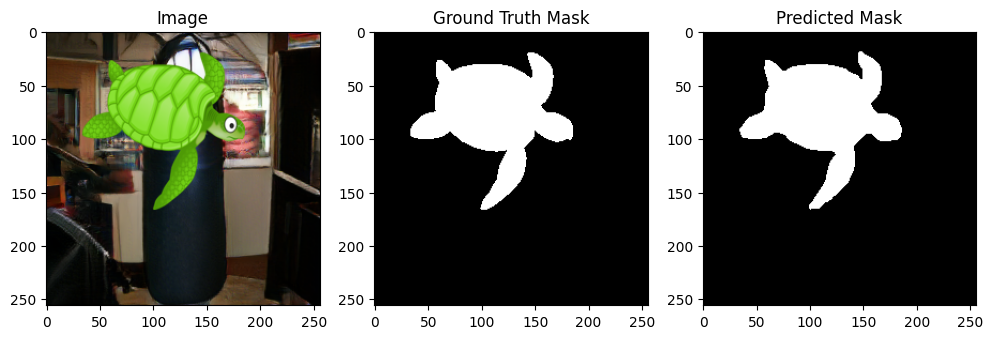

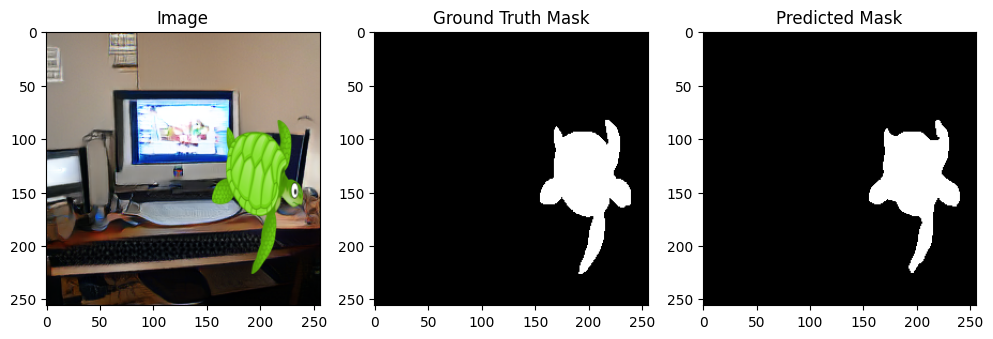

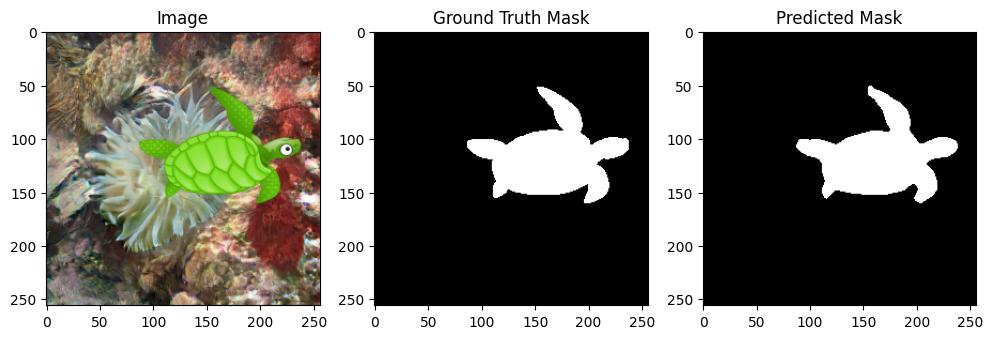

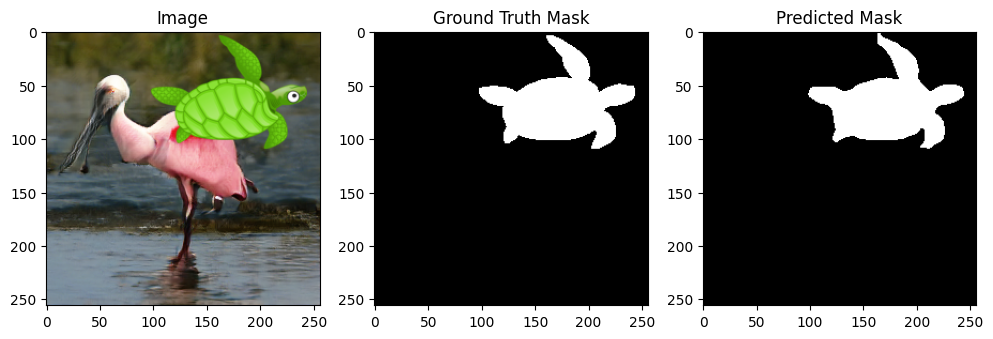

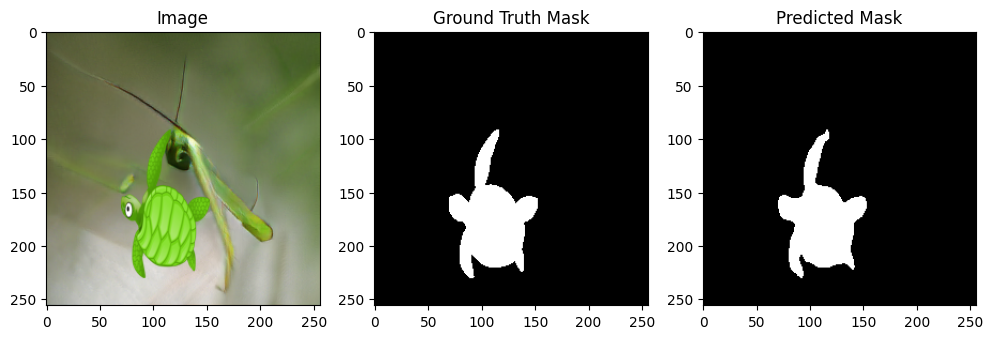

Exception ignored in: <function _xla_gc_callback at 0x78683caaf010>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 98, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


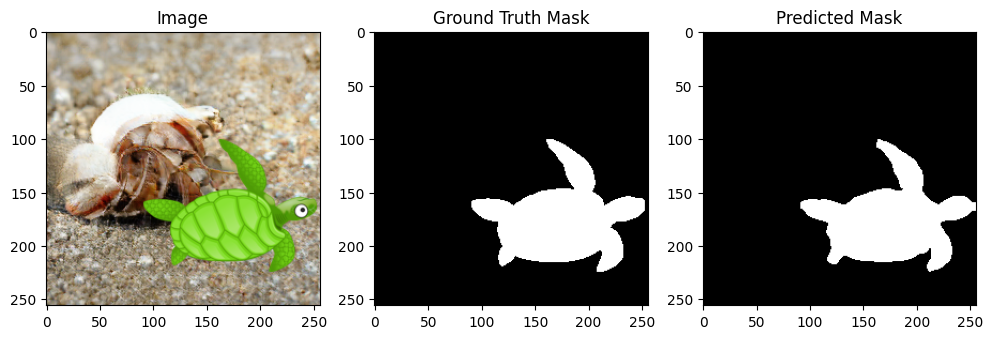

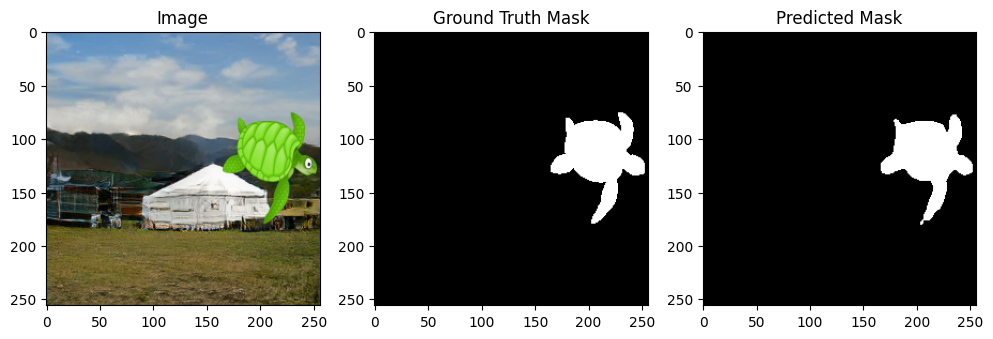

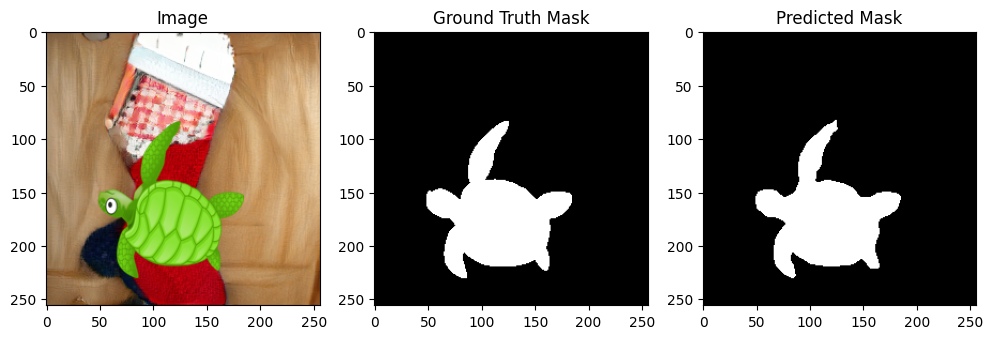

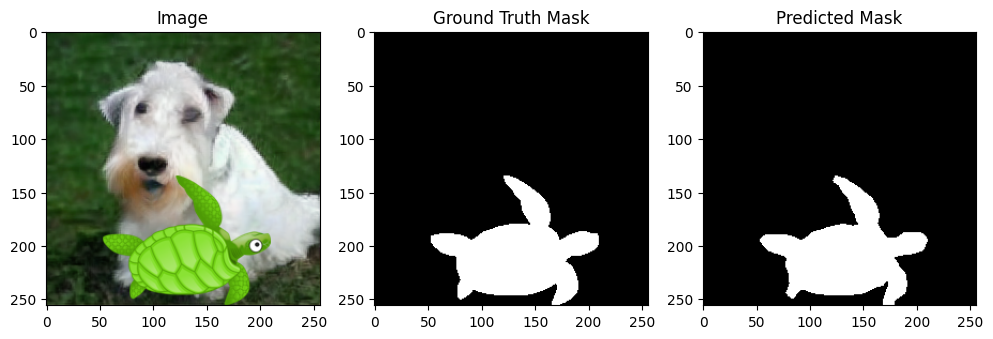

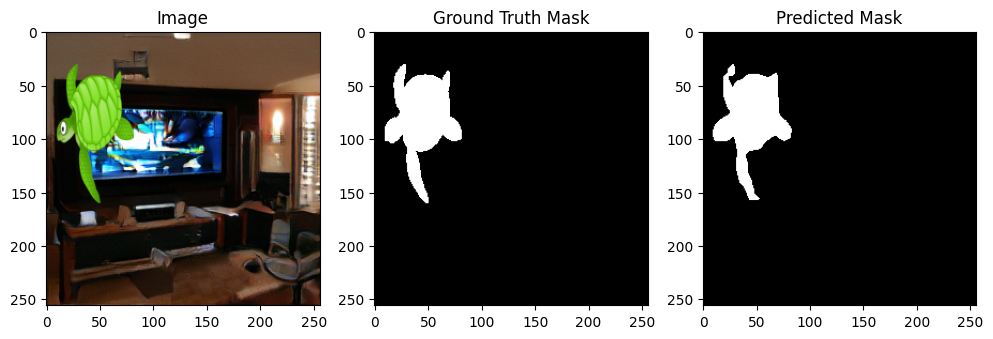

...

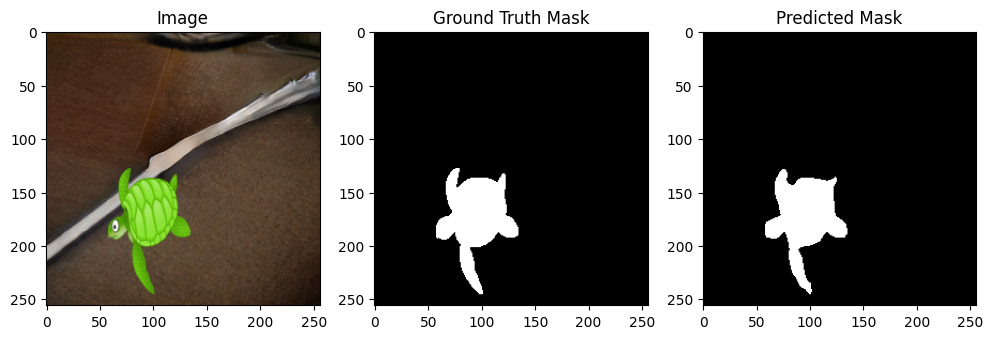

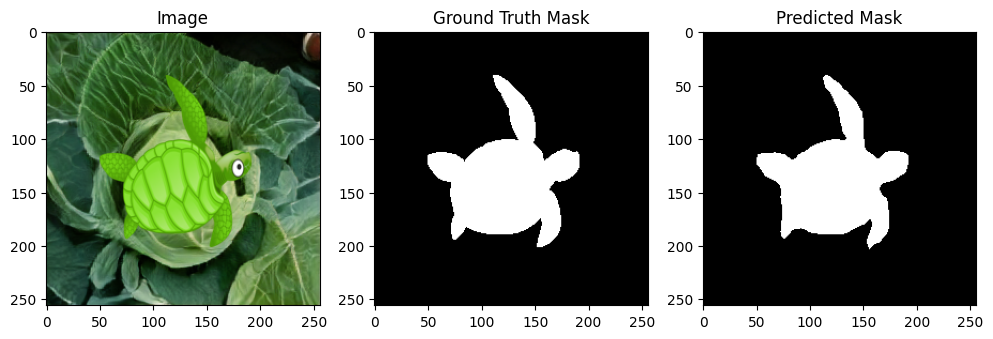

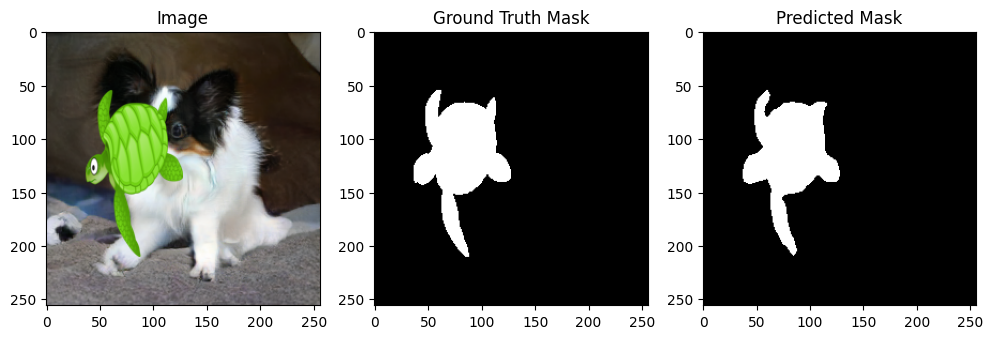

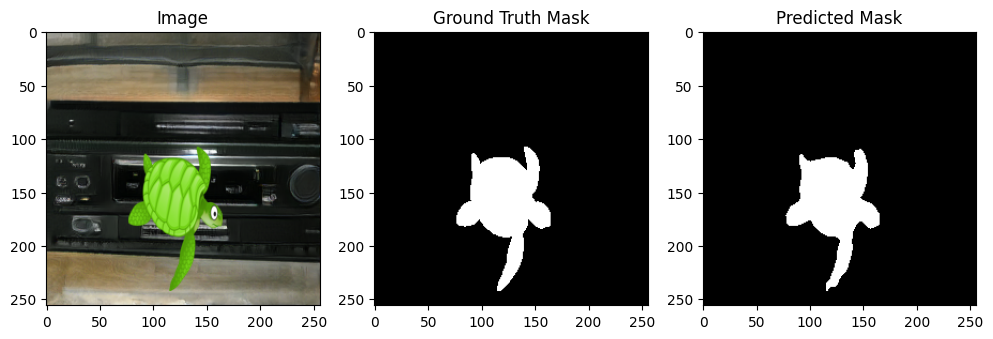

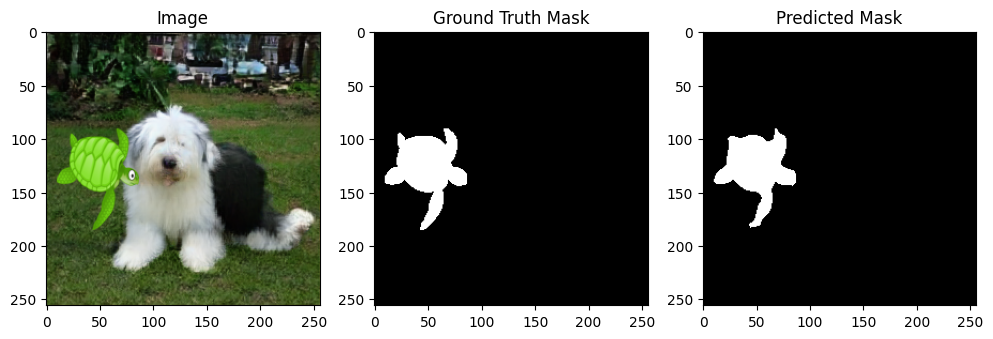

Exception ignored in: <function _xla_gc_callback at 0x78683caaf010>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 98, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


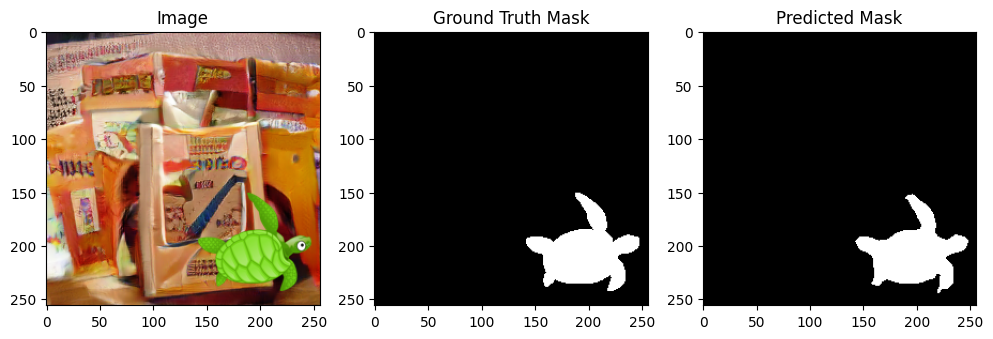

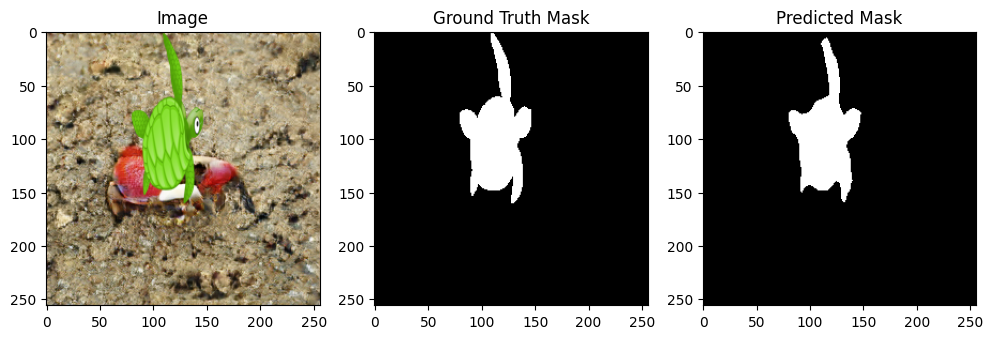

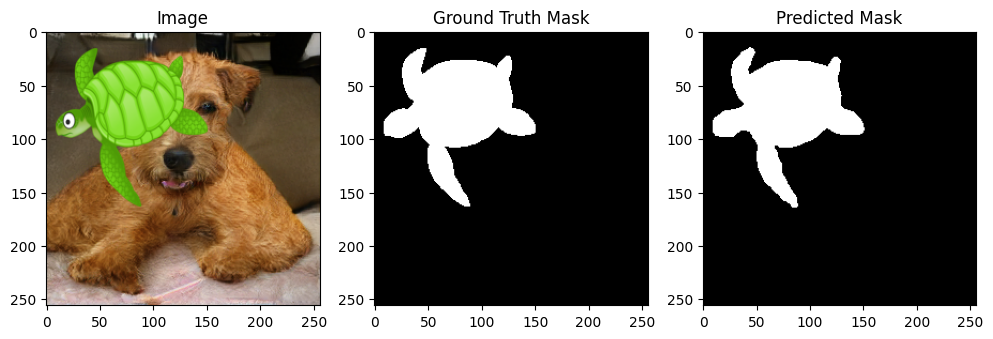

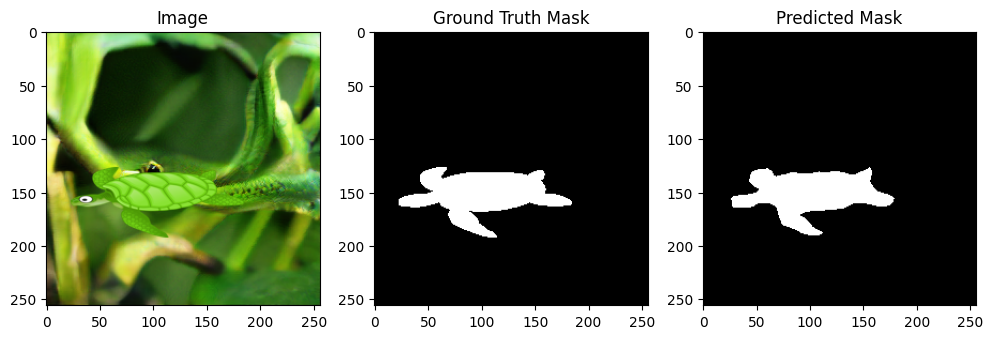

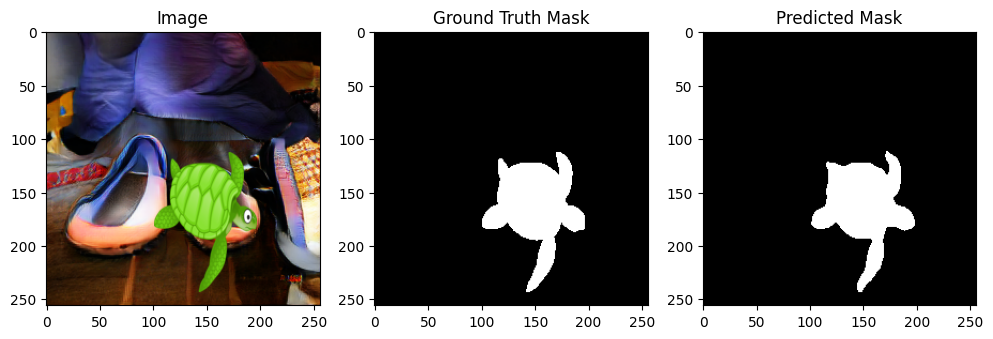

...

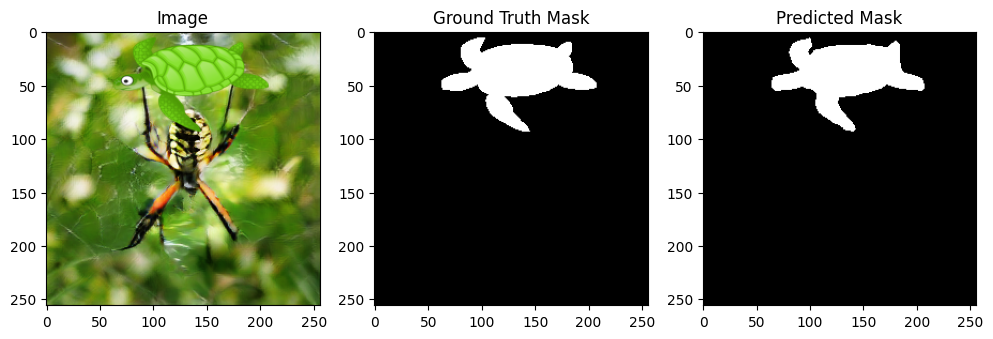

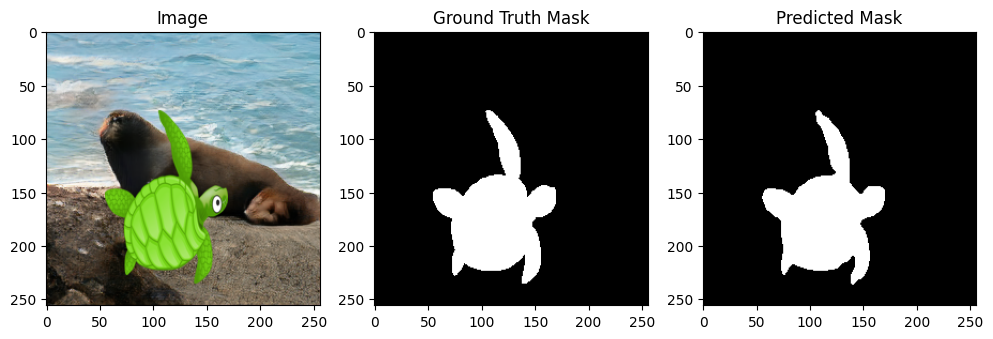

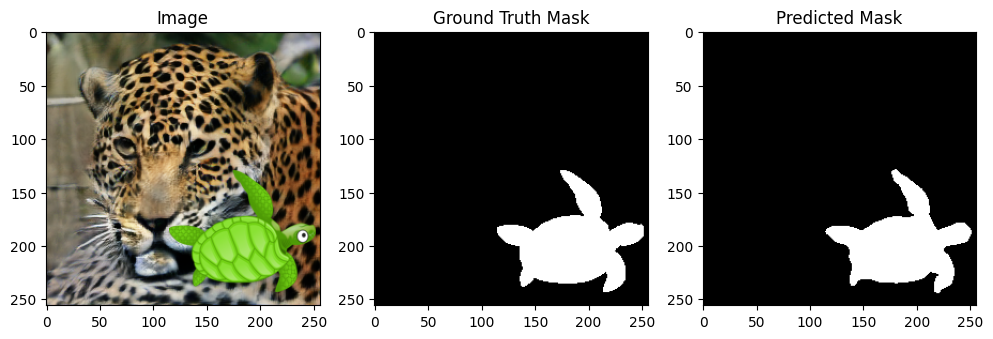

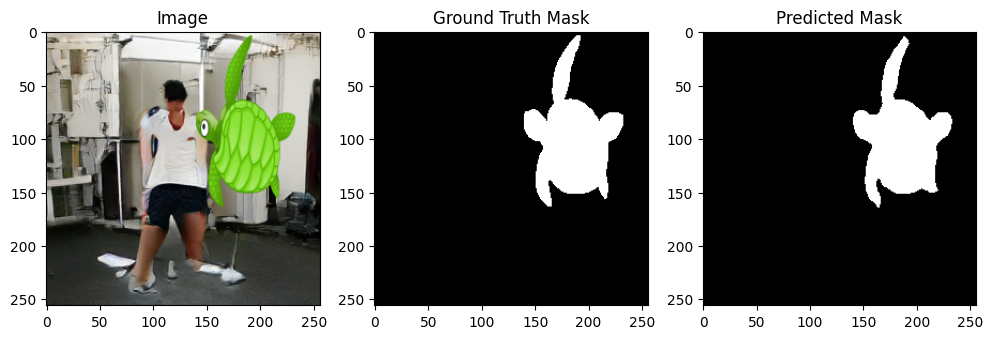

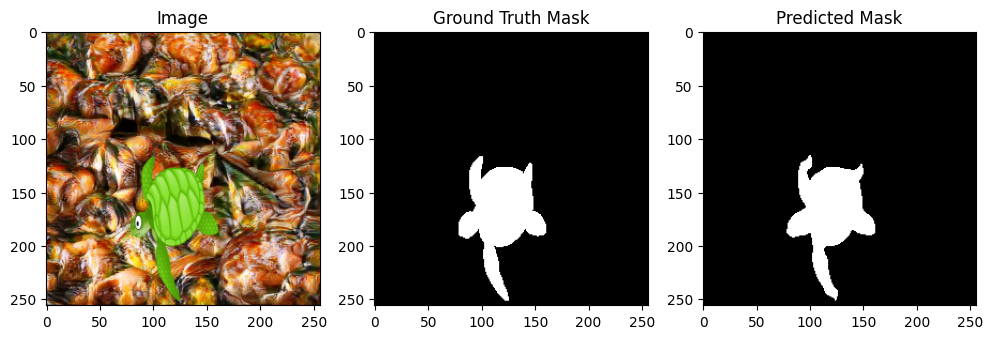

KeyboardInterrupt: 

In [63]:
test_model(unet_model, data_loader)

In [ ]:
def single_image_mask_generate(model, images, device='cuda'):
    """
    Generates predicted masks for a single image using the provided model.

    Parameters:
        model (UNet): U-Net model for mask prediction.
        images (torch.Tensor): Input images for which masks are to be generated.
        device (str): Device to run the inference on. Default is 'cuda'.

    Returns:
        torch.Tensor: Predicted masks.
    """
    model.eval()
    with torch.no_grad():
      images = images.to(device)
      outputs = model(images)

      predicted_masks = torch.argmax(outputs, dim=1)
      visualize_results_single(images, predicted_masks)
    return predicted_masks


def visualize_results_single(images, predicted_masks):
    """
    Visualizes the results of mask prediction for a single image.

    Parameters:
        images (torch.Tensor): Input images.
        predicted_masks (torch.Tensor): Predicted masks.
    """
    num_samples = images.size(0)
    for i in range(1):
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(images[i].permute(1, 2, 0).cpu().numpy())
        plt.title('Image')



        plt.subplot(1, 3, 3)
        plt.imshow(predicted_masks[i].cpu().numpy(), cmap='gray')
        plt.title('Predicted Mask')

        plt.show()

#### Connecting the google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
model_path = '/content/drive/MyDrive/saved_model.pth'

# Save the model's parameters to the .pth file
torch.save(unet_model.state_dict(), model_path)

NameError: ignored

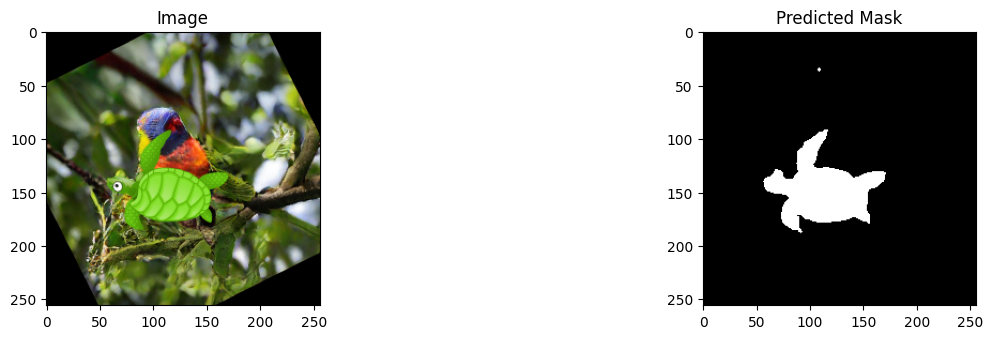

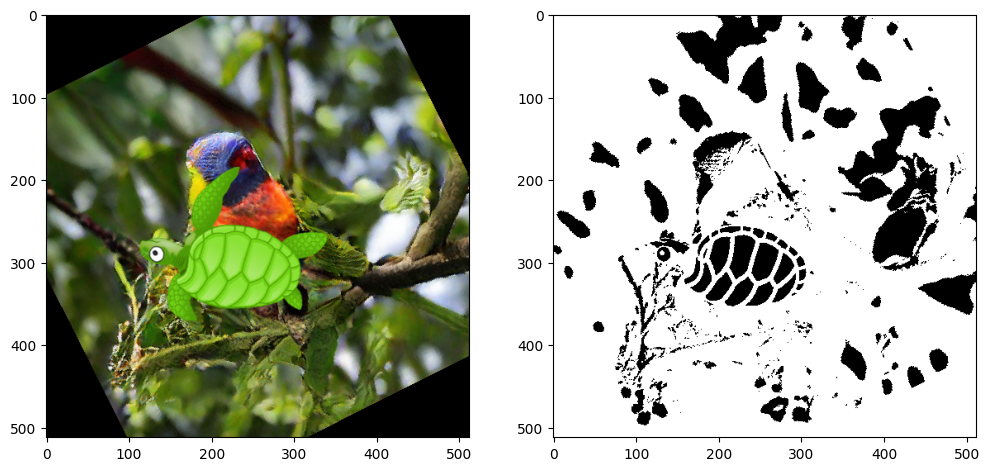

In [ ]:
# TODO: Implement and train the deep model

# TODO: Save the model weights and upload them to Google Drive

load_model_weights = True
if load_model_weights:
    # After uploading your saved model weights to Google Drive, share to
    # "Anyone with the link" and extract FILE_ID from the share link
    # See https://support.google.com/drive/answer/2494822?hl=en&co=GENIE.Platform%3DDesktop

    # My Model : https://drive.google.com/file/d/1-1xgh9u7CsZc4I4VKUaNWV18AmDglLKN/view?usp=drive_link

    # for more information
    # Now the weights can be downloaded and used via gdown:

    saved_model_url = "https://drive.google.com/uc?id=1-1xgh9u7CsZc4I4VKUaNWV18AmDglLKN"
    gdown.download(saved_model_url, "saved_model.pth", quiet=True)

    unet_model = UNet(in_channels=3, out_channels=2)  # Assuming 2 classes (foreground and background)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Load the state_dict instead of the entire OrderedDict
    state_dict = torch.load("saved_model.pth", map_location=device)

    # If the state_dict is saved with DataParallel, remove 'module.' prefix
    if 'module.' in list(state_dict.keys())[0]:
        state_dict = {k[7:]: v for k, v in state_dict.items()}

    # Load the state_dict into the model
    unet_model.load_state_dict(state_dict)


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
unet_model = unet_model.to(device)
test_image_tensor = tensor_transform(test_image)

def get_mask_from_image(test_image):
  # TODO: Use the deep model that predicts the segmentation mask on the test image
  # The model with the saved weights should be used, if load_model_weights is True
  # Resize the test image to match the expected input size
  resized_image = F.interpolate(test_image_tensor.unsqueeze(0), size=(256, 256), mode='bilinear', align_corners=False)
  res = single_image_mask_generate(unet_model, resized_image)
  test_mask = test_image.mean(0) < 0.5
  return test_mask.byte(), res

test_mask_tensor, res = get_mask_from_image(test_image_tensor)


plt.figure(figsize=(12, 12))
plt.subplot(121)
plt.imshow(test_image_tensor.numpy().transpose(1, 2, 0))
plt.subplot(122)
plt.imshow(test_mask_tensor.numpy(), cmap="gray", vmin=0, vmax=1)

#### The model doesnt give a proper mask

There are other smaller section, we can train it again by rotating the input image and we train more but to make it simpler based on input, dropping small object sizes

In [ ]:
import cv2

In [ ]:
temp =res[0].cpu().numpy().astype(np.uint8) * 255
ret, thresh = cv2.threshold(temp, 127, 255, 0) # We can skip this step
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

result_image = temp.copy()
for i in range(len(contours)):
  if len(contours[i]) <= 100:
    cv2.drawContours(result_image, contours, i, (0, 0, 0), -1)

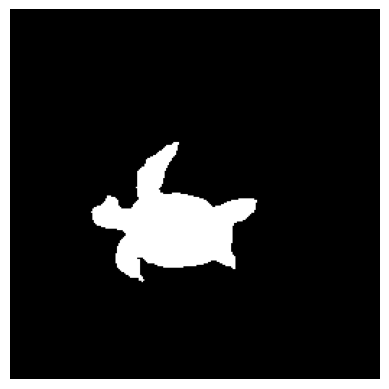

In [ ]:
result_image_rgb = cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB)
# Display the result using Matplotlib
plt.imshow(result_image_rgb)
plt.axis('off')  # Turn off axis labels
plt.show()

Successfully removed the smaller contours.

### Upscale the image fron 256\*256 to 512\*512

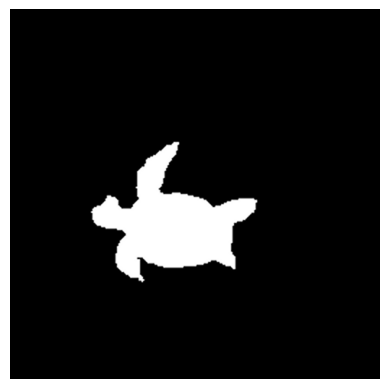

In [ ]:
upscaled_size = (512, 512)
# Upscale the image using cv2.resize
upscaled_image = cv2.resize(result_image, upscaled_size, interpolation=cv2.INTER_CUBIC)
result_image_rgb = cv2.cvtColor(upscaled_image, cv2.COLOR_BGR2RGB)

plt.imshow(result_image_rgb)
plt.axis('off')  # Turn off axis labels
plt.show()

# Task 2: Calculating tight enclosing polygon from segmentation mask

*This is where you need to implement your algorithm that predicts a **convex hull** (not concave), an enclosing polygon of foreground pixels. You are not allowed to use cv2, scikit-image or other libraries' functionality that readily solve this task. Treat this problem as point-based (using pixel coordinates) rather than image-based.*

*You don't have to use PyTorch for this part. Your approach must output a result at the native 512x512 resolution of the test image.*

*For the purposes of this assignment, O(n^2) is considered a good time complexity*

In [ ]:
def convex_hull(points):
    """
    Computes the convex hull of a set of points using the Jarvis March algorithm.

    Parameters:
        points (numpy.ndarray): 2D array representing the coordinates of points.

    Returns:
        list: List of points forming the convex hull.
    """
    def orientation(p, q, r):
        """
        Determines the orientation of three points (p, q, r).
        Returns 0 if colinear, 1 if clockwise, and 2 if counterclockwise.

        Parameters:
            p (tuple): Coordinates of point p.
            q (tuple): Coordinates of point q.
            r (tuple): Coordinates of point r.

        Returns:
            int: Orientation value (0, 1, or 2).
        """
        val = (q[1] - p[1]) * (r[0] - q[0]) - (q[0] - p[0]) * (r[1] - q[1])
        if val == 0:
            return 0
        return 1 if val > 0 else 2

    def jarvis_march(points):
        """
        Applies the Jarvis March algorithm to find the convex hull of a set of points.

        Parameters:
            points (numpy.ndarray): 2D array representing the coordinates of points.

        Returns:
            list: List of points forming the convex hull.
        """
        n = len(points)
        if n < 3:
            return []

        hull = []

        l = np.argmin(points, axis=0)[0]  # Leftmost point
        p = l  # Start from the leftmost point

        while True:
            hull.append(points[p])
            q = (p + 1) % n
            for r in range(n):
                if orientation(points[p], points[r], points[q]) == 2:
                    q = r
            p = q

            if p == l:
                break

        return hull

    # Filter out the coordinates of the foreground pixels
    foreground_pixels = [(x, y) for x in range(points.shape[0]) for y in range(points.shape[1]) if points[x, y] > 0]

    # Calculate the convex hull of the foreground pixels
    hull = jarvis_march(np.array(foreground_pixels))

    return hull

<ipython-input-30-76e3e10e4dbc>:12: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:261.)
  return torch.tensor(hull_points)


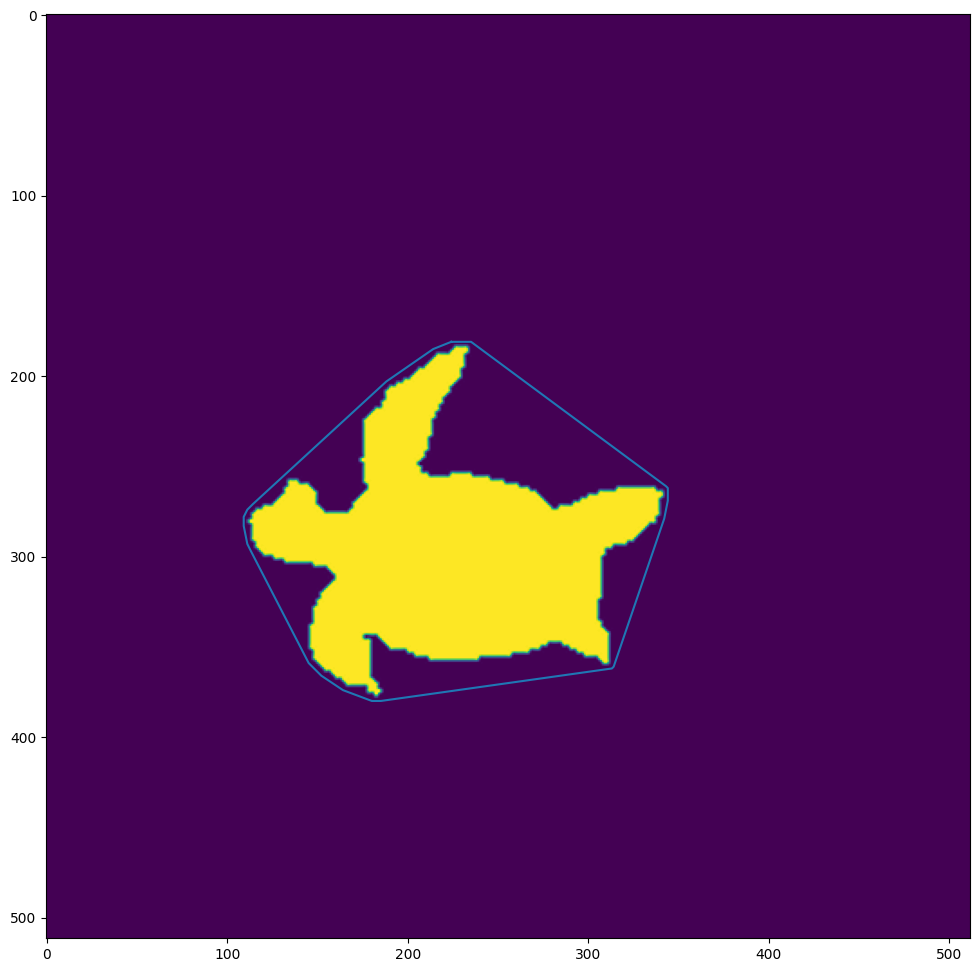

In [ ]:
def get_tight_polygon_from_mask(test_mask):
  """
    Computes the tight convex polygon from a binary mask using the convex_hull function.

    Parameters:
        test_mask (numpy.ndarray): Binary mask.

    Returns:
        torch.Tensor: Tensor representing the tight convex polygon points.
  """
  hull_points = convex_hull(test_mask)
  return torch.tensor(hull_points)

def visualize_polygon_on_image(test_image, polygon_points_n2):
  """
    Visualizes a convex polygon on an image.

    Parameters:
        test_image (numpy.ndarray): Input image.
        polygon_points_n2 (torch.Tensor): Tensor representing the polygon points.

    Returns:
        None
  """
  polygon_points_n2 = torch.cat([polygon_points_n2, polygon_points_n2[:1]], 0)
  ys, xs = torch.split(polygon_points_n2, 1, dim=-1)

  plt.figure(figsize=(12, 12))
  plt.imshow(test_image)
  plt.plot(xs.numpy(), ys.numpy()) # Draw the lines


polygon_points_n2_tensor = get_tight_polygon_from_mask(upscaled_image)
visualize_polygon_on_image(upscaled_image, polygon_points_n2_tensor)


# Task 3: Calculating the area of the polygon

<!-- > Indented block -->


*This is where you need to implement your area calculation algorithm. You are not allowed to use cv2, scikit-image or other libraries' functionality that readily solve this task. Once again, treat this problem as a point-based rather than an image-based one.*

*You don't have to use PyTorch for this part. Your approach must output a result at the native 512x512 resolution of the test image.*

In [ ]:
def convex_hull_area(hull_points):
    """
    Calculates the area of a convex hull using the shoelace formula.

    Parameters:
        hull_points (list): List of coordinates representing the convex hull points.

    Returns:
        float: Area of the convex hull.
    """
    n = len(hull_points)
    if n < 3:
        return 0  # Convex hull must have at least 3 points

    area = 0
    for i in range(n):
        x1, y1 = hull_points[i]
        x2, y2 = hull_points[(i + 1) % n]
        area += (x1 * y2 - x2 * y1)

    return abs(area) / 2.0  # Take the absolute value and divide by 2 to get the area

# Assuming 'hull_points' is a list of coordinates of the convex hull points
# For example: hull_points = [(x1, y1), (x2, y2), ...]

# Calculate the area of the convex hull
hull_area = convex_hull_area(polygon_points_n2_tensor)

print("Area of the convex hull:", hull_area)

Area of the convex hull: tensor(32027.)


# Approach

### Orientation

As the test image is of the turtle upside down. I added in total 4 different orientations of the turtle.


*   Original
*   Vertically inverted
*   Horizontally inverted
*   Vertically and Horizontally inverted


### Dataset

Selected 40 background images and pasted the 4 different in each and got a total of 160 images.



*   We should train on more background images, and find the places where the turtle will be seen, because the training images has lot of green patches around the turtle. A few shot training approach with less epochs wouldn't perform masking to max efficiency.



### Training

DeepLabV3 model with a ResNet-50 backbone for image segmentation, with random weights initialized.



*   Used cross entropy loss with background and foreground pixel classification.
*   Epochs = 100, learning rate = 0.001, used adam optimizer.



### Testing

The built model works exceptionally for the training dataset.

* As the test image is 512*512 I downsampled it using bilinear interpolation to size 256*256 as the model was trained for an input of size (256*256).
* The output of the test image has some foreground patches extra on the side, so we do contour approach and remove the smaller contours.

### Calculating tight enclosing

Used Gift wrapping algorithm to find the tight enclosing polygon.

The Gift Wrapping algorithm, also known as Jarvis March, finds the convex hull of a set of points by iteratively selecting the next point with the smallest polar angle with respect to the current point. It operates in O(nh) time complexity, where n is the number of input points and h is the number of points on the convex hull, making it a straightforward and commonly used method for convex hull computation.

### Calculating the area

Used the shoelace algorithm to calculate the area.The shoelace formula works because it leverages the principles of vector cross products to calculate the area of a polygon. The formula is based on the observation that the magnitude of the cross product of two vectors gives the area of the parallelogram formed by those vectors.